# Car brand detection with YoloV5

This notebook has been provided to test the weights that were derived from the training process. These weights were gained from training a data which consisted of roughly 620 images. These 620 images were divided over 5 classes, which represent 5 brands: Toyota, Mercedes, Audi, Volkswagen and BMW. Data augmentation was applied so that the data size could be increased. This was mainly done to improve the overall results of the model. In the end, we came out with roughly 1500 images that are spread out over 5 different classes. The dataset was split up into 70% training, 20% validation and 10% test. After the appliance of augmentation of the data, it got split into 88% training, 8% validation and 4% test data.

This dataset was trained around five different times where we tried different amount of epochs, batch-sizes and optimizers. The epochs were tested up to a maximum of 300 epochs. We noticed that the preformance was stale at around the 200 mark which meant that the remaining 100 epochs would be considered as overfitting, so we retrained on 200 epochs and this ended up yielding an average accuracy of 95%. We also trained the dataset on the SGD and Adam optimizers. Both yielded good results, but Adam had slightly higher accuracy by roughly 1% which boosted the average accuracy up to 96%. The batch-size did not matter as much, but we ended up going with 16 since majority of other tutorials also used this number of batch-size.The average loss of this last training session was 0.025686 where box loss was 0.01792, object loss was 0.005704 and class loss was 0.002062. Furthermore, we did not use any pretrained weights, only the pretrained YoloV5 model. This means that our weights were freshly made from the training process without any appliance of transfer learning techniques.

Despite the good training results, the model is still far from perfect. This is primarily due to the data size because we do have many pictures of different kind of variants of each logo. There are still occassional problems where the model does not recognize a logo or where it guesses the logo incorrectly or even when it assumes that a different object is a logo. There are also a lot of instances where Audi is not properly being detected when paired with other cars of different brands. In other words, there is a lot of room for improvement and we plan to capitalize on this in the near future when writing our advisory report. Nonetheless, we are still quite pleased with our results as we did not expect to get such high accuracy with such a limited dataset.

The code for the training and detection process has not been included in this notebook because it would take a gruesome amount of time to train and also take a lot of GPU/CPU power. On top of this, the model was trained using an external GPU from CUDA and was trained in Google Collab environment because it has access to external commands which the Jupyter Notebook does not like. We did not see a requirement where we have to also upload our source code that we used to train the model, but if this is the case, please let us know. Despite this, we still would like to provide the link to the Google Collab where we trained the model. If you would like to look at it, you can access through the link mentioned in the chapters 1. The results of this, however, can be viewed in chapter 2 of this notebook (if you do not want to run the code)

The overall premise of this notebook is to show you what the training and testing results were as well as give you the option to use our weights that we gained from training our dataset of the pretrained YoloV5 model. If you want to see the training and test results, start from chapter 2 so you can briefly see what we were able to achieve with our given data. If you want to test our weights, skip to chapter 3 where you can enter any amount of images and run the cell to test the predictions.

# 1. Training of the model on the data

As already mentioned above, we used Google Colab to training our dataset on the YoloV5 model. Some of the commands cannot get executed within Jupyter Notebook. Sometimes it gives us hard time to get things done such as training with YoloV5. This is quite unfortunate, but we would still nonetheless like to provide you with a link to the Google Colab if you are interested in the training process

https://colab.research.google.com/drive/1i8ZZ8CMZzAeCQ6yk6Lg2O87DUD5olT2s?usp=sharing

## 2. Training & test results

We have added an additional folder which contains the results of the training process, along with other additional graphs and images. These results reside within the "training_results" folder. This folder has two additional folders. The "train" folder contains all of the information regarding the training processes, such as curve diagrams, percision, recall, confusion matrix, etc. The "detect" folder contains the images of the test dataset which were used to run an inference on.

In [ ]:
import torch
import glob
from IPython.display import Image, display

### 2.1 Result graphs

This brief shows of how the process of the training process went. There are more graphs and batches which can be viewed within the "yolov5s_results" folder if needed.

In [ ]:
print("Result graphs")
Image(filename='training_results/train/yolov5s_results/results.png', width=1000)

### 2.2 Training data results
This shows the results of the training data.

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='training_results/train/yolov5s_results/val_batch0_labels.jpg', width=900)

### 2.2 Training data results with augmentation
This shows the results of the training data with augmentation

In [ ]:
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='training_results/train/yolov5s_results/train_batch0.jpg', width=900)

### 2.3 Confusion matrix

This displays a confusion matrix of the training process. Within here, the error and success rate of the prediction between all classes can be viewed.

In [ ]:
print("Confusion matrix:")
Image(filename='training_results/train/yolov5s_results/confusion_matrix.png', width=900)

### 2.4 Inference on test data / test results
This displays the results of the inferenace of the Yolov5 model using the training weights on the test data.

In [ ]:
for imageName in glob.glob('training_results/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")  

## 3. Model testing / inference on new data

This is just a simple code snippet of that can be used to  you can test the weights retrieved from the training process on the pretrained YoloV5 model from ultralytics. The weights that were trained reside within the "trained_model_weights" folder. The "test_images" folder contains some of the images you can test this model on. Feel free to add your own.

Using cache found in C:\Users\Alex/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2023-4-14 Python-3.10.9 torch-2.0.0+cpu CPU

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7257306 parameters, 0 gradients
Adding AutoShape... 


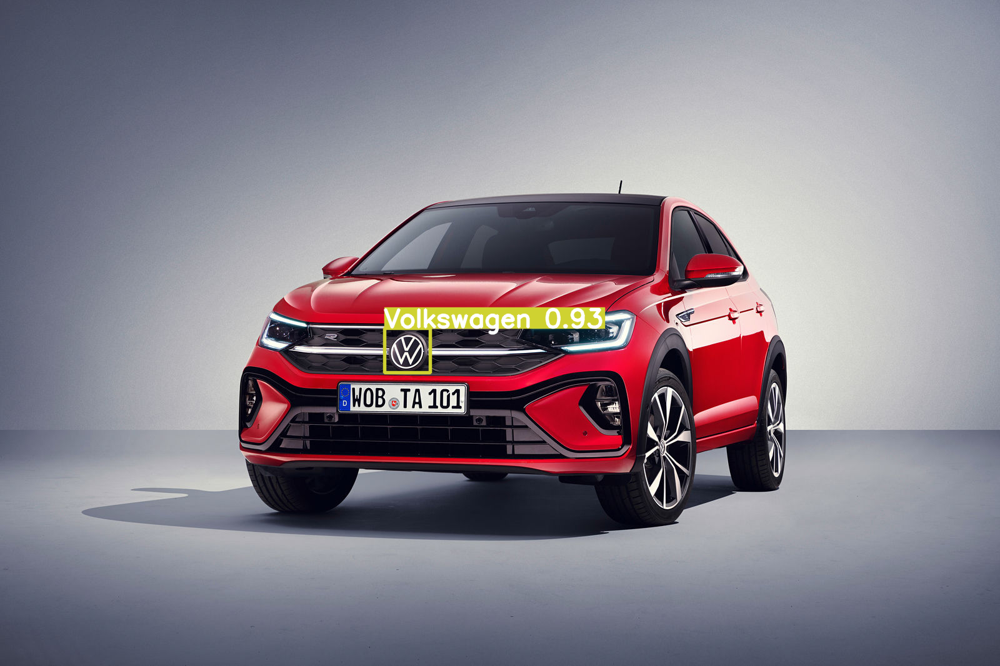

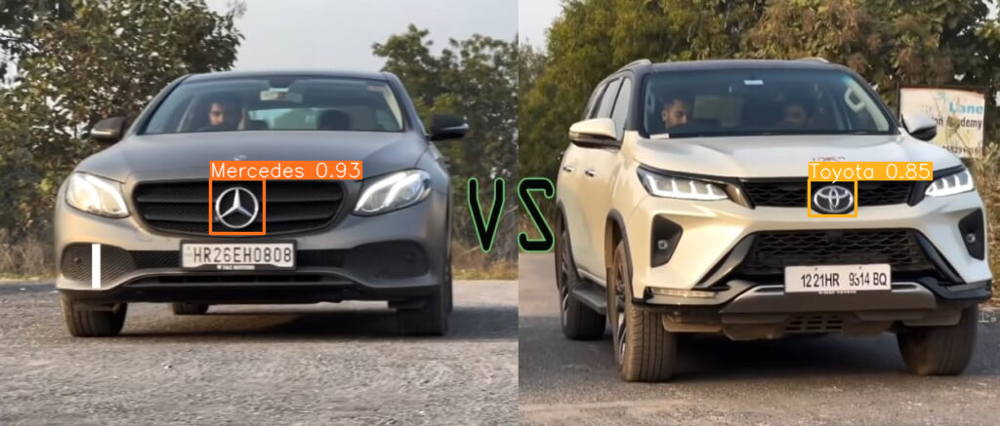

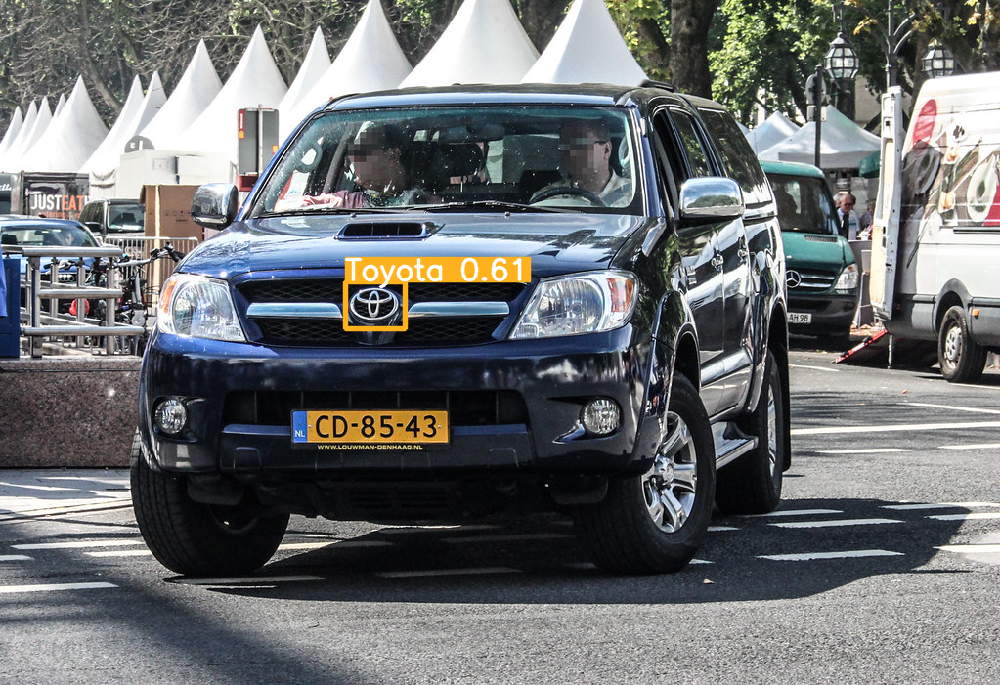

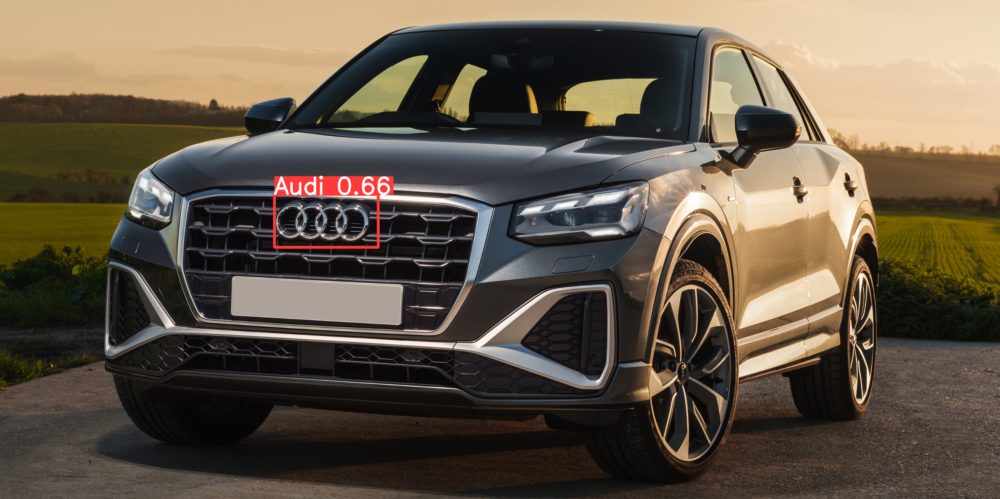

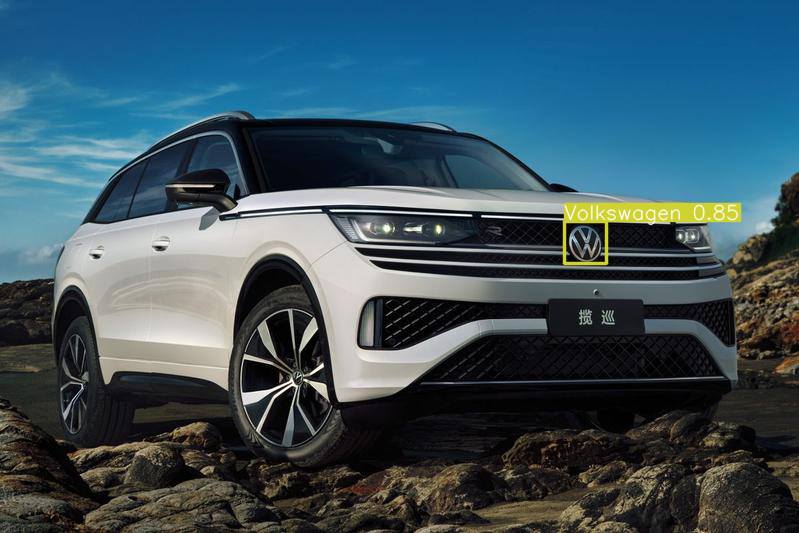

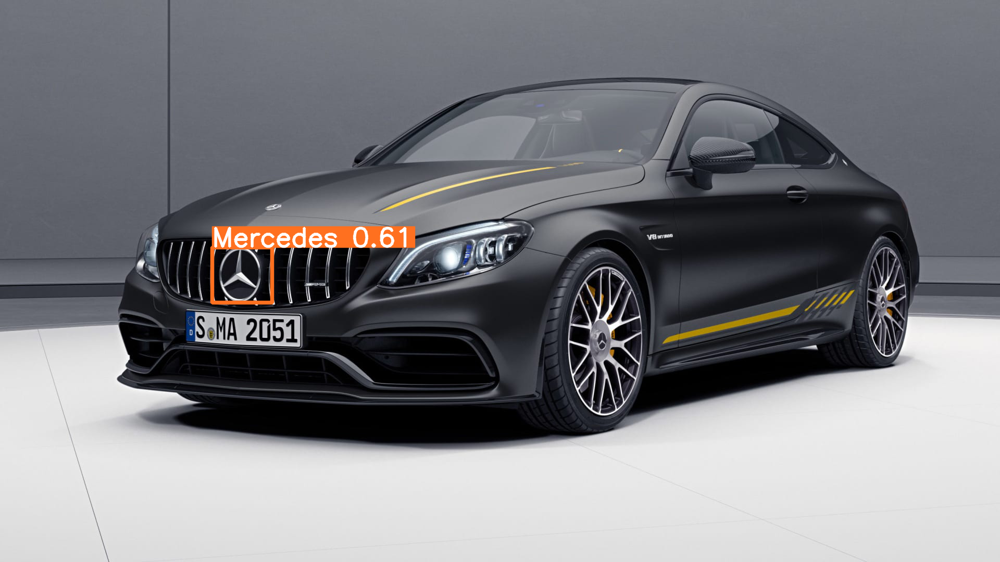

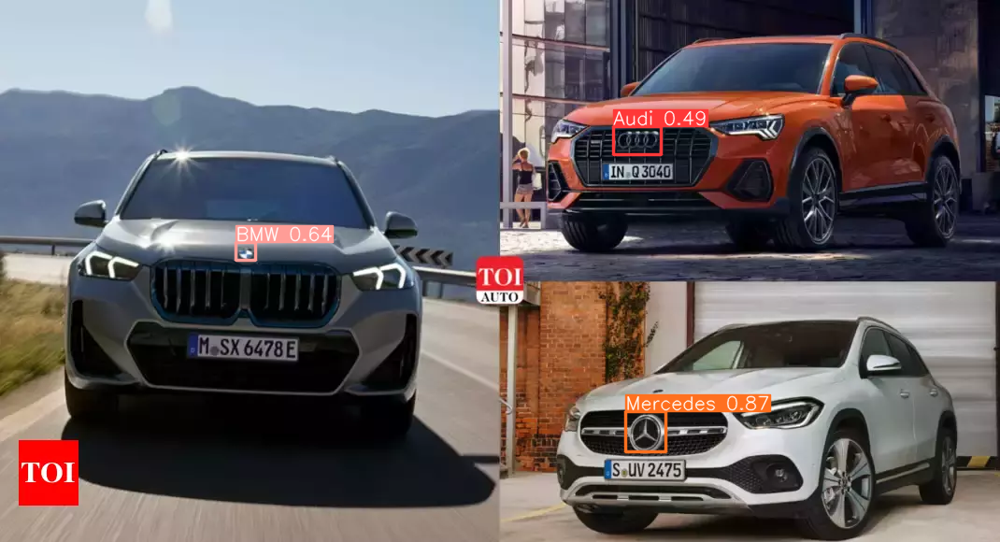

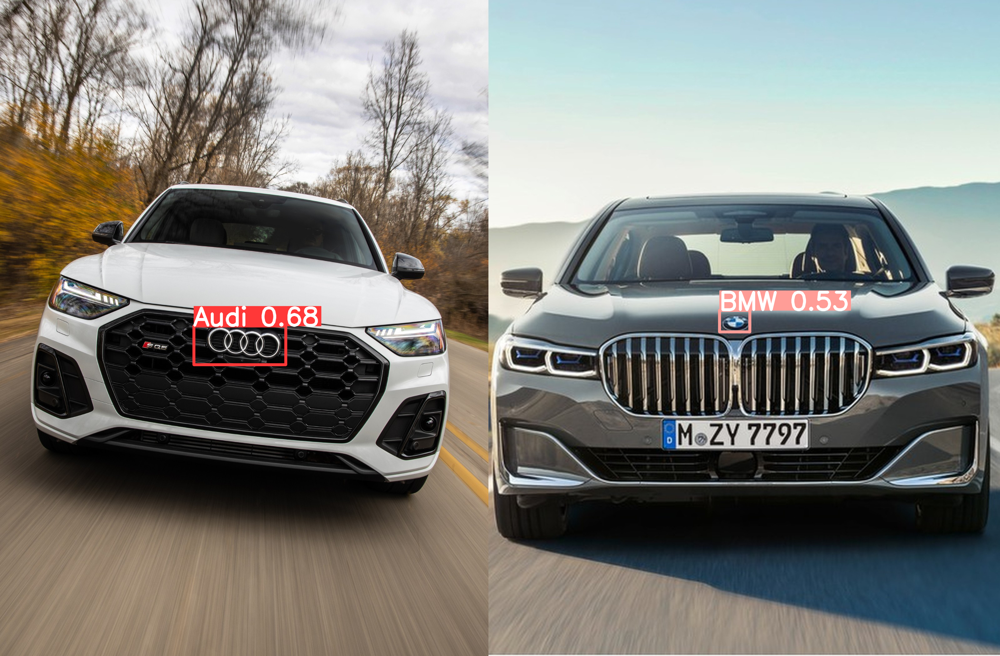

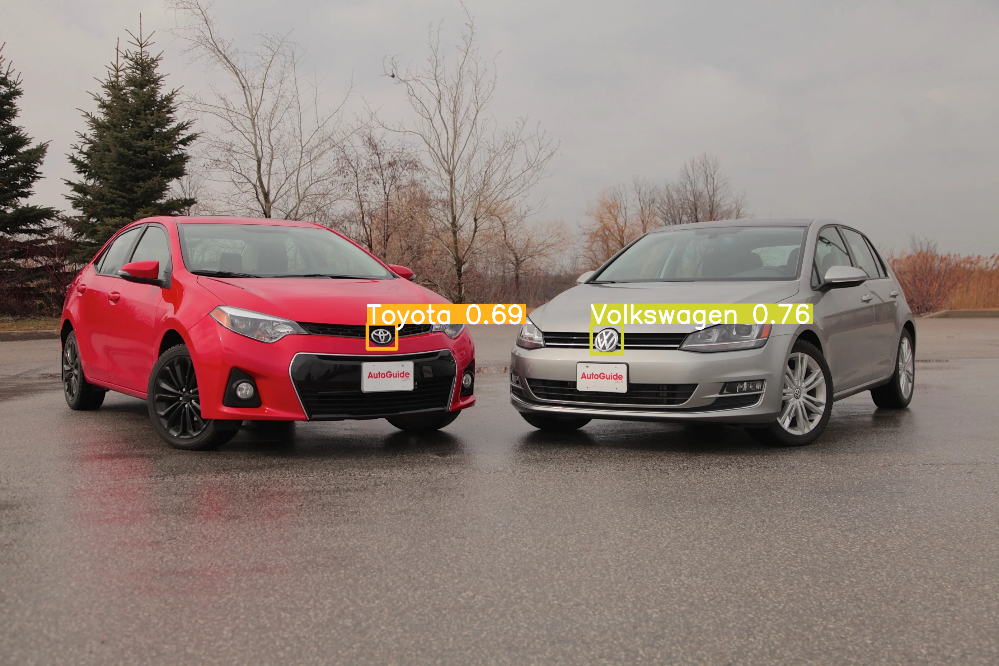

In [11]:
model = torch.hub.load('ultralytics/yolov5', 'custom', path='trained_model_weights/200_epoch_adam_brand_detection.pt') # the path leads to the weights of the trained model

for imageName in glob.glob('test_images/*.jpg'): #pride the same format as specified (JPG)
    results = model(imageName)
    results.show()
    print("\n") 